# GIK2KM Data Science & Machine Learning

Dalarna University, spring 2022

© Joonas Pääkkönen

## Lab 6: Machine Learning

### Deadline: Wednesday May 25th, 2022, 23:59 CET time

It is okay to work in pairs. However, if you work with another student, add his or her name below, too.

Upload your .ipynb file to Learn. Use file name format “labX firstname lastname studentid.ipynb",
e.g., “lab6 jim jonsson v21abcde hanna jansson v21abcda.ipynb”.

Note: each student needs to hand in his/her solution on Learn even if (s)he worked in a pair.

For grade G: execute all the given tasks.

Use Scikit-learn first and foremost, with the help of Pandas, NumPy, SciPy, Matplotlib and Seaborn, if needed.
Remember that Pandas dataframes come in very handy in data science.
Note: pairplots may take several seconds or even minutes to plot depending on how fast your system is.

Plagiarism: Do not blindly copy-paste anything.
You need to be able to explain your solution and analyse the results.
The plagiarism rules of the university apply.
As explained above, you may work in pairs but in that case, add both names and email addresses below.

Do not modify this header information other than adding your name(s) and email(s) below:

### Remember to fill in the information below, student name(s) and email address(es).

### Student name(s):  Mouayad Mouayad

### DU email address(es):  h20moumo@du.se

## Task 1: Binary classification with logistic regression

In [318]:
import pandas as pd

Task 1.1: Download the DryBeanDataset.zip file from
https://archive.ics.uci.edu/ml/datasets/Dry+Bean+Dataset and save Dry_Bean_Dataset.xlsx to variable "beandata". You need to read an .xlsx file now.

In [397]:
df = pd.read_excel('beandata.xlsx')

Task 1.2: Print the beandata dataset by simply writing the variable name.

In [320]:
df

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,Class
0,28395,610.291,208.178117,173.888747,1.197191,0.549812,28715,190.141097,0.763923,0.988856,0.958027,0.913358,0.007332,0.003147,0.834222,0.998724,SEKER
1,28734,638.018,200.524796,182.734419,1.097356,0.411785,29172,191.272750,0.783968,0.984986,0.887034,0.953861,0.006979,0.003564,0.909851,0.998430,SEKER
2,29380,624.110,212.826130,175.931143,1.209713,0.562727,29690,193.410904,0.778113,0.989559,0.947849,0.908774,0.007244,0.003048,0.825871,0.999066,SEKER
3,30008,645.884,210.557999,182.516516,1.153638,0.498616,30724,195.467062,0.782681,0.976696,0.903936,0.928329,0.007017,0.003215,0.861794,0.994199,SEKER
4,30140,620.134,201.847882,190.279279,1.060798,0.333680,30417,195.896503,0.773098,0.990893,0.984877,0.970516,0.006697,0.003665,0.941900,0.999166,SEKER
5,30279,634.927,212.560556,181.510182,1.171067,0.520401,30600,196.347702,0.775688,0.989510,0.943852,0.923726,0.007020,0.003153,0.853270,0.999236,SEKER
6,30477,670.033,211.050155,184.039050,1.146768,0.489478,30970,196.988633,0.762402,0.984081,0.853080,0.933374,0.006925,0.003242,0.871186,0.999049,SEKER
7,30519,629.727,212.996755,182.737204,1.165591,0.513760,30847,197.124320,0.770682,0.989367,0.967109,0.925480,0.006979,0.003158,0.856514,0.998345,SEKER
8,30685,635.681,213.534145,183.157146,1.165852,0.514081,31044,197.659696,0.771561,0.988436,0.954240,0.925658,0.006959,0.003152,0.856844,0.998953,SEKER
9,30834,631.934,217.227813,180.897469,1.200834,0.553642,31120,198.139012,0.783683,0.990810,0.970278,0.912125,0.007045,0.003008,0.831973,0.999061,SEKER


Task 1.3: Use the describe() method to describe the dataset.

In [398]:
# removing null values to avoid errors 
df.dropna(inplace = True) 
# percentile list
perc =[.20, .40, .60, .80]
# list of dtypes to include
include =['object', 'float', 'int']
des = print(df.describe(percentiles = perc, include = include))   
des

                 Area     Perimeter  MajorAxisLength  MinorAxisLength  \
count    13611.000000  13611.000000     13611.000000     13611.000000   
unique            NaN           NaN              NaN              NaN   
top               NaN           NaN              NaN              NaN   
freq              NaN           NaN              NaN              NaN   
mean     53048.284549    855.283459       320.141867       202.270714   
std      29324.095717    214.289696        85.694186        44.970091   
min      20420.000000    524.736000       183.601165       122.512653   
20%      34671.000000    687.045000       246.970229       171.241483   
40%      41138.000000    754.888000       276.427665       186.664689   
50%      44652.000000    794.941000       296.883367       192.431733   
60%      49022.000000    849.569000       325.380666       198.401177   
80%      67359.000000   1015.390000       388.675385       227.880576   
max     254616.000000   1985.370000       738.86015

Task 1.4: Use Seaborn to plot the pairplots of the dataset with the hue argument set to the class of the bean. Note that there are several kinds of beans. Follow the link in Task 1.1 to read more details about the data.

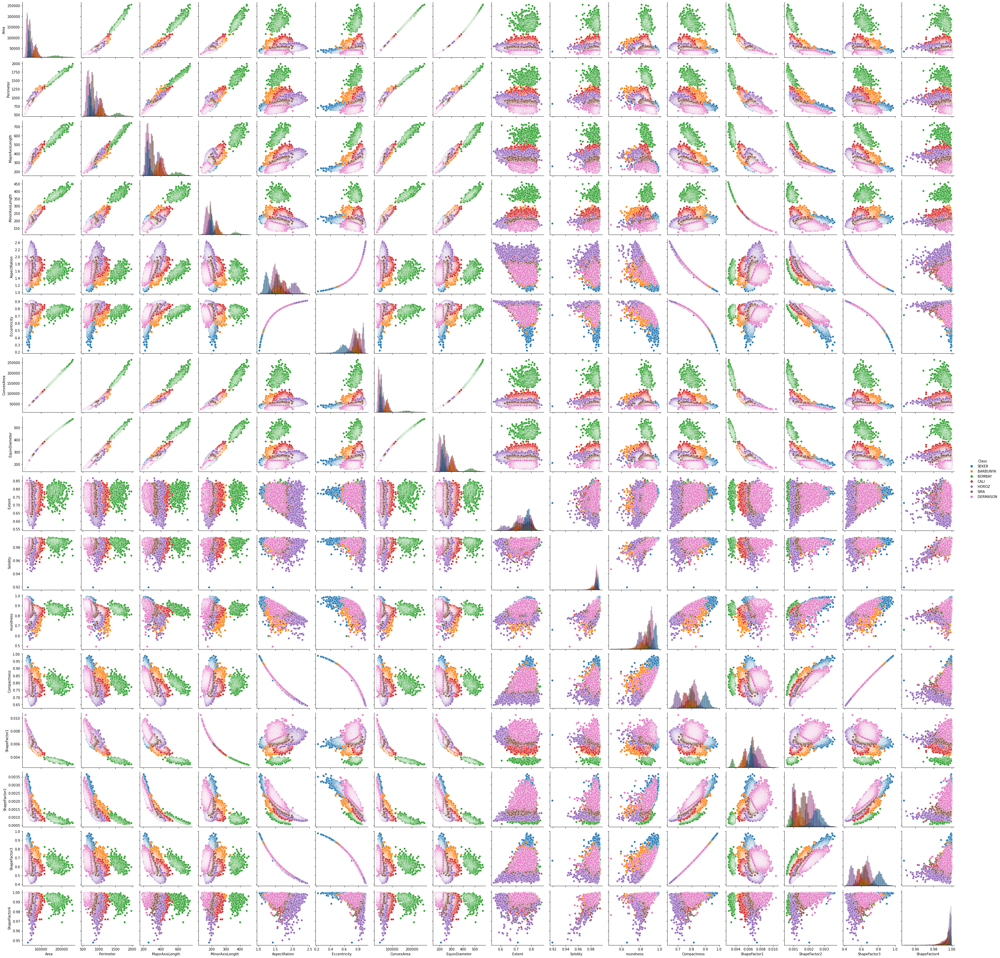

In [400]:
import seaborn as sns

sns.pairplot(df, diag_kind="hist" ,hue="Class")

# ax = sns.boxplot(x="MajorAxisLength" ,y="MinorAxisLength" , hue="Class",
#                  data=df, linewidth=2.5)

# print(ax)

Task 1.5: Let's say we are only interested in Bombay beans. Use Scikit-learn to build a logistic regression predictor based on the major axis length of the beans to separate Bombay beans from other beans. Plot the regression curve in the same figure with the corresponding scatterplot.

[[1.77635684e-15 1.00000000e+00]
 [6.66133815e-16 1.00000000e+00]
 [3.33066907e-15 1.00000000e+00]
 ...
 [1.17790222e-11 1.00000000e+00]
 [1.46769263e-11 1.00000000e+00]
 [5.97475402e-11 1.00000000e+00]]


<AxesSubplot:>

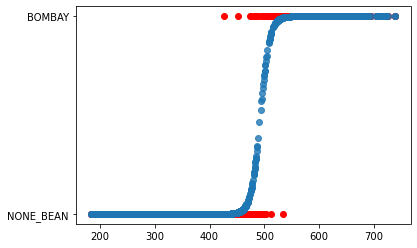

In [368]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

X = df.MajorAxisLength.values.reshape(-1,1)
Y = df.iloc[:,16].values
bombaylist = []
for bean in Y:
    if bean == "BOMBAY":
        bombaylist.append(bean)
    else:
        bombaylist.append("NONE_BEAN")
        
# X_train, X_test, Y_train, Y_test = train_test_split(X,bombaylist,test_size=0.5,random_state=2)
clf = LogisticRegression(random_state=0).fit(X,bombaylist)
y_pred = clf.predict_proba(X)

print(y_pred)
plt.scatter(X, bombaylist, color="red")
sns.regplot(x=X, y=y_pred[:,0], logistic=True, ci=None)

Task 1.6: Use the score() method to evaluate the accuray of the model.

In [369]:
from sklearn import preprocessing
y_pred = clf.predict(X)
clf.score(X,Y)

0.037616633605172284

Task 1.7: How would you describe the accuracy in your own words? Write your answer in English (or Swedish) here:

In [325]:
# the accurancy mean that we have 0.037 right  prediction 

## Task 2: kNN classification

Task 2.1: Let's say now we are interested in classifying all the beans, not just Bombay beans, but we only know the "AspectRation" and the "Area" of the beans, in addition to the corresponding "Class" of the beans. Use Scikit-learn to build a kNN classifier with $k=3$. Train the model with a random $70\%$ selection of the whole dataset, and leave the remaining $30\%$ of the dataset as the test set. Plot the confusion matrix for the test set.

In [370]:
data = pd.DataFrame(df,columns =["Class","AspectRation","Area"])

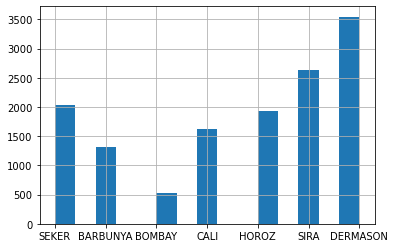

In [371]:
import matplotlib.pyplot as plt
data["Class"].hist(bins=15)
plt.show()


In [372]:
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error
from math import sqrt
X = data.drop("Class", axis=1)
X = X.values
Y = data["Class"]
classes_name= []
for i in Y:
    if(i == 'SEKER'):
        classes_name.append(0)
    if(i == 'BARBUNYA'):
        classes_name.append(1)
    if(i == "BOMBAY"):
        classes_name.append(2)
    if(i == "CALI"):
        classes_name.append(3)
    if(i == "HOROZ"):
        classes_name.append(4)
    if(i == "SIRA"):
        classes_name.append(5)
    if(i == "DERMASON"):
        classes_name.append(6)

X_train, X_test, y_train, y_test = train_test_split(X, classes_name, test_size=0.3, random_state=70)



knn_model = KNeighborsRegressor(n_neighbors=3)
knn_model.fit(X_train, y_train)
train_preds = knn_model.predict(X_train)


mse = mean_squared_error(y_train, train_preds)
rmse = sqrt(mse)
print("RMSE :",rmse)


test_preds = knn_model.predict(X_test)
mse = mean_squared_error(y_test, test_preds)
rmse = sqrt(mse)
print("predictive performances on the test set :",rmse)

RMSE : 1.456257613465882
predictive performances on the test set : 2.0741308343574736


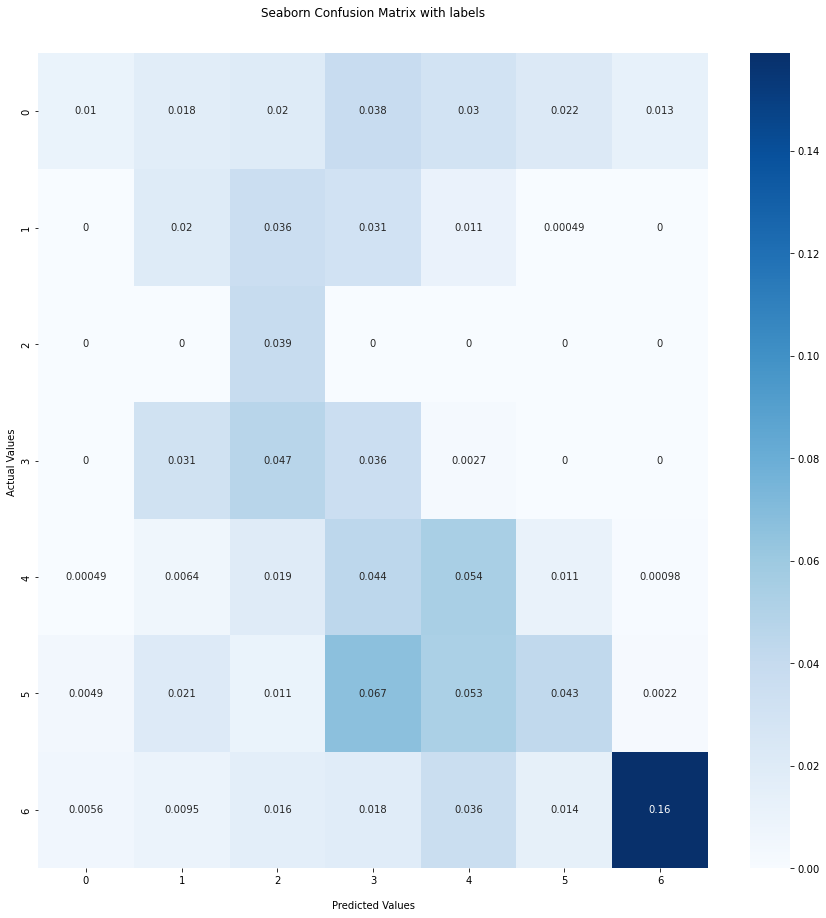

[[ 42  72  82 155 122  91  52]
 [  0  83 145 125  44   2   0]
 [  0   0 158   0   0   0   0]
 [  0 127 191 147  11   0   0]
 [  2  26  79 181 221  46   4]
 [ 20  84  43 274 216 174   9]
 [ 23  39  66  74 148  56 650]]


In [373]:
from sklearn.metrics import classification_report,confusion_matrix
from sklearn.model_selection import cross_val_score


from sklearn.preprocessing import StandardScaler
import seaborn as sns


y_pred_list= []
for i in test_preds:
    y_pred_list.append(int(i))
    

    
    
cf_matrix = confusion_matrix(y_test, y_pred_list)
plt.figure(figsize=(15, 15))
ax = sns.heatmap(cf_matrix/np.sum(cf_matrix), annot=True, cmap='Blues')
ax.set_title('Seaborn Confusion Matrix with labels\n\n');
ax.set_xlabel('\nPredicted Values')
ax.set_ylabel('Actual Values ');


plt.show()


print(cf_matrix)


Task 2.2: Describe what you see in your own words. How good are the results? Write your answer here:




In [376]:
#each box in the matrix present the time the prediction data was good predection compared withe the real data
#the best prediction withe 16%  is the best 6:6 block 

## Task 3: k-means clustering

Task 3.1: Plot the pairplot of beandata with hue set to "Class".

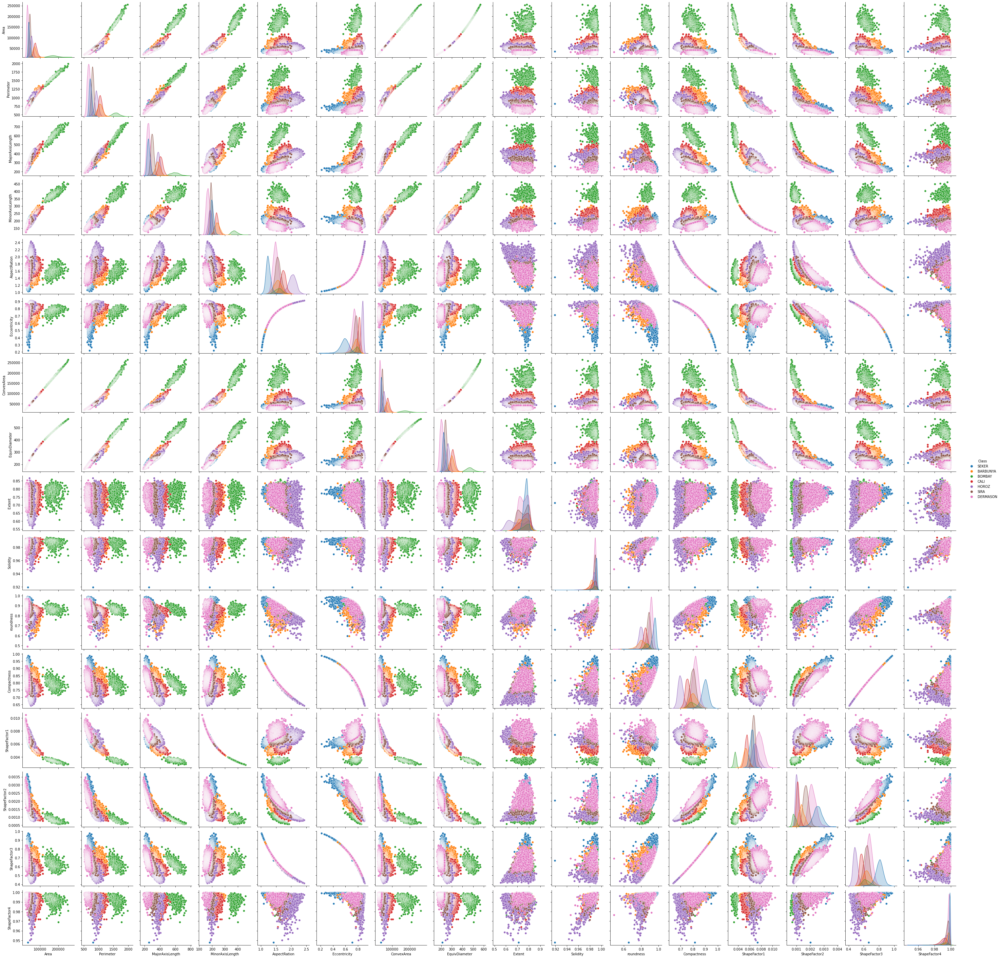

In [330]:
sns.pairplot(df, hue="Class")

Task 3.2: Plot a scatterplot with compactness on the x-axis and minor axis length on the y-axis. Here all the datapoints should have the same color.


<AxesSubplot:xlabel='Compactness', ylabel='MinorAxisLength'>

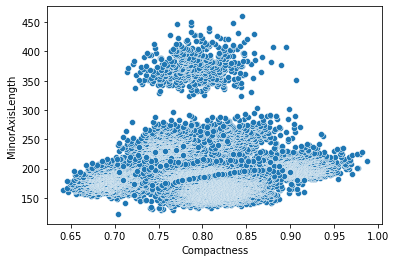

In [331]:
sns.scatterplot(data=df, x="Compactness", y="MinorAxisLength")

Task 3.3: Use the Sklearn k-means algorithm to cluster the data into $k=2$ clusters, and plot a scatterplot that shows the clusters in different colors.

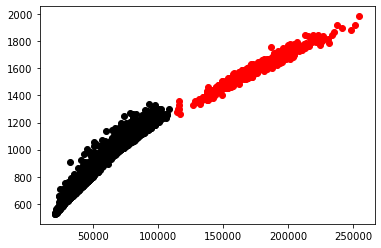

In [332]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import numpy as np
X = df.drop("Class", axis=1)

label = KMeans(n_clusters=2,random_state=0).fit_predict(X)

label_0 = df[label == 0]
label_1 = df[label == 1]



cols = X.columns

plt.scatter(label_0[cols[0]], label_0[cols[1]], color = 'red')
plt.scatter(label_1[cols[0]], label_1[cols[1]], color = 'black')
plt.show()



Task 3.4: Use Sklearn to find and print the silhouette score of the clustering of Task 3.3.

In [333]:
from sklearn.metrics import silhouette_score
print(f'Silhouette Score(n=2): {silhouette_score(X, label)}')


Silhouette Score(n=2): 0.8418055406860053


Task 3.5: Use the Sklearn k-means algorithm to cluster the data into $k=3$ clusters, and plot a scatterplot that shows the three clusters in different colors.

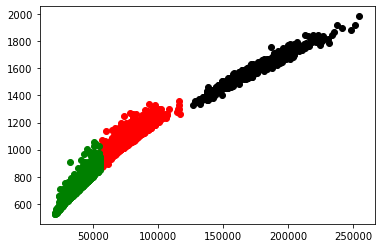

In [334]:
X = df.drop("Class", axis=1)

label = KMeans(n_clusters=3,random_state=0).fit_predict(X)
import matplotlib.pyplot as plt

label_0 = X[label == 0]
label_1 = X[label == 1]
label_2 = X[label == 2]


cols = X.columns

plt.scatter(label_0[cols[0]], label_0[cols[1]], color = 'red')
plt.scatter(label_1[cols[0]], label_1[cols[1]], color = 'black')
plt.scatter(label_2[cols[0]], label_2[cols[1]], color = 'green')
plt.show()

Task 3.6: Use Sklearn to find and print the silhouette score of the clustering of Task 3.5.

In [335]:
print(f'Silhouette Score(n=3): {silhouette_score(X, label)}')

#As you can see in the above figure clusters are not well apart. 
#The inter cluster distance between cluster 1 and cluster 2 is almost negligible.
#That is why the silhouette score for n= 3(0.596) is lesser than that of n=2(0.806).

#When dealing with higher dimensions, the silhouette score is quite useful 
#to validate the working of clustering algorithm as we can’t use any type of
#visualization to validate clustering when dimensions are greater than 3.

Silhouette Score(n=3): 0.6647284829799174


Task 3.7: Which number of clusters, $k=2$ or $k=3$, gave the better performance in terms of the silhouette score? Are the results in line with what you see in the figures? Which number of clusters seems more suitable when you look at the scatterplots? Explain in your own words below.

In [336]:
# can see clusters are well apart if we got a silhouette score near to 1 
# k2 givs bettar preformance because  Silhouette Score is higher than k3 
# and the k2 look betar alsow on the scatter plot 

## Task 4: Comparing clustering algorithms

Task 4.1: Download buddymove_holidayiq.csv from https://archive.ics.uci.edu/ml/datasets/BuddyMove+Data+Set and save it to a variable called buddydata.

In [377]:
df = pd.read_csv('buddymove_holidayiq.csv')
pd.set_option('display.max_rows', None)
print(df)

      User Id  Sports  Religious  Nature  Theatre  Shopping  Picnic
0      User 1       2         77      79       69        68      95
1      User 2       2         62      76       76        69      68
2      User 3       2         50      97       87        50      75
3      User 4       2         68      77       95        76      61
4      User 5       2         98      54       59        95      86
5      User 6       3         52     109       93        52      76
6      User 7       3         64      85       82        73      69
7      User 8       3         54     107       92        54      76
8      User 9       3         64     108       64        54      93
9     User 10       3         86      76       74        74     103
10    User 11       3        107      54       64       103      94
11    User 12       3        103      60       63       102      93
12    User 13       3         64      82       82        75      69
13    User 14       3         93      54       7

Task 4.2: Use Seaborn to plot the pairplot so that each datapoint has the same color.

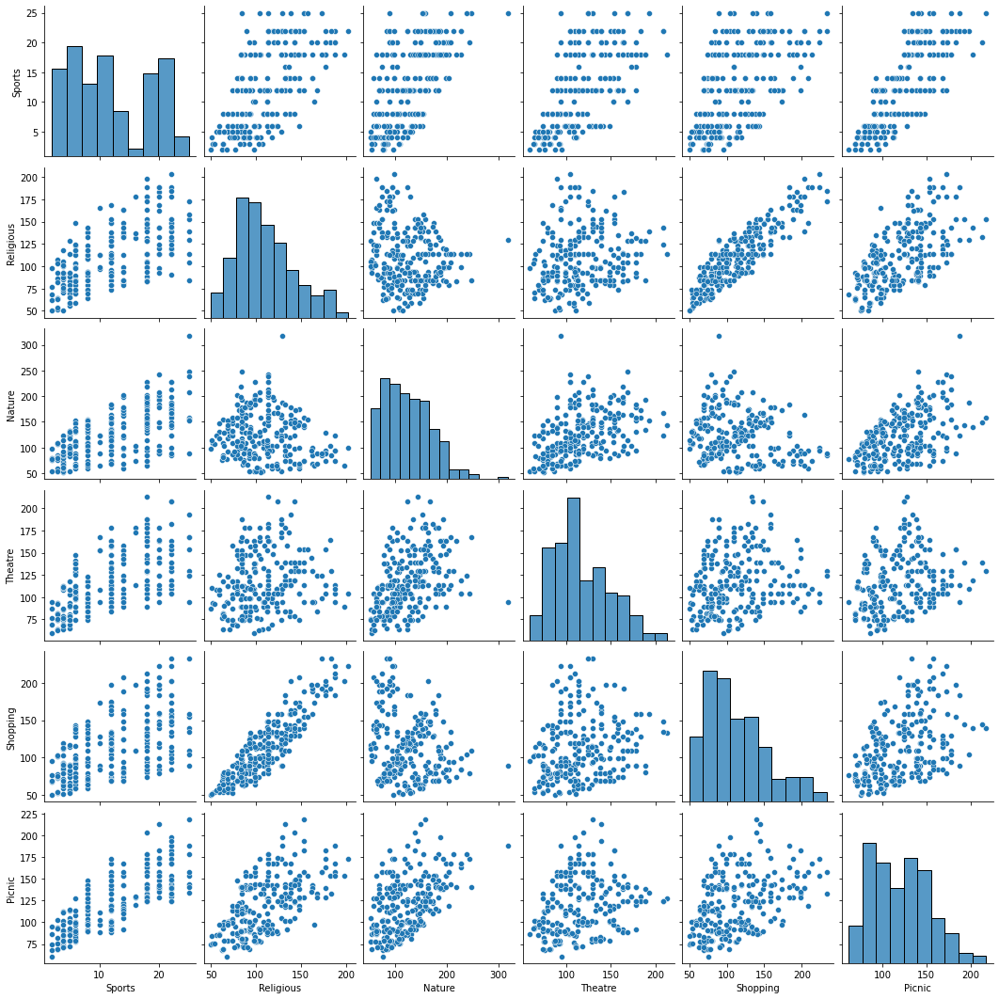

In [354]:
sns.pairplot(df, diag_kind="hist")


Task 4.3: By looking at the pairplot, one might argue that based on features Nature and Shopping, the users could be grouped into 3 separate clusters. Plot only this scatterplot, with Nature on the x-axis and Shopping on the y-axis.

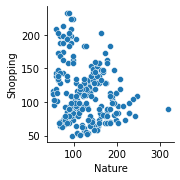

In [378]:
sns.pairplot(df, x_vars=["Nature"], y_vars=[ "Shopping"])


Task 4.4: Assuming that we have 3 different user groups, how would you describe each of these groups by looking at the scatterplot? Explain in your own words below based on how many reviews the users of each user group have made. See the website referred to in Task 4.1. for explanations of the features. 

In [340]:
#Some users have done many more reviews in one category than the other category,  the same time some of them have 
# made reviews, approximately the same number in both categories
#that's why we see the data in that way 

Task 4.5: Use Sklearn to build a k-means clustering model (for the 2-dimensional dataset of Task 4.3) with $k=3$, plot the corresponding scatterplot so that datapoints belonging to different clusters have different colors, and finally also print the corresponding silhouette score.

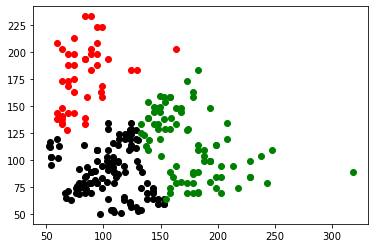

Silhouette Score(n=3): 0.4228422010203888


In [381]:
columns = ['Nature', 'Shopping']
df = pd.read_csv('buddymove_holidayiq.csv')

data = pd.DataFrame(df, columns=columns)
# print(data)
scaler = StandardScaler()
# transform data
scaled = scaler.fit_transform(data)

cols = data.columns

label = KMeans(n_clusters=3,random_state=0).fit_predict(data)

label_0 = data[label == 0]
label_1 = data[label == 1]
label_2 = data[label == 2]

plt.scatter(label_0[cols[0]], label_0[cols[1]], color = 'red')
plt.scatter(label_1[cols[0]], label_1[cols[1]], color = 'black')
plt.scatter(label_2[cols[0]], label_2[cols[1]], color = 'green')
plt.show()

print(f'Silhouette Score(n=3): {silhouette_score(X, label)}')

Task 4.6: Use Sklearn to build a Gaussian mixture clustering model with 3 mixture components, plot the corresponding scatterplot so that datapoints belonging to different clusters have different colors, and finally also print the corresponding silhouette score.

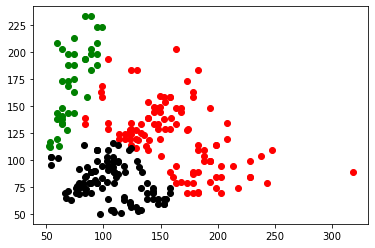

Silhouette Score(n=3): 0.3744025787171322


In [382]:
# from sklearn.mixture import  GMM
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(n_components=3).fit(scaled)
labels = gmm.predict(scaled)

label_0 = data[labels == 0]
label_1 = data[labels == 1]
label_2 = data[labels == 2]
plt.scatter(label_0[cols[0]], label_0[cols[1]], color = 'red')
plt.scatter(label_1[cols[0]], label_1[cols[1]], color = 'black')
plt.scatter(label_2[cols[0]], label_2[cols[1]], color = 'green')
plt.show()
# print(labels)
# plt.scatter(data[:, 0], data[:, 1], c=labels, s=40, cmap='viridis');
# gm = GMM(n_components=3, random_state=0).fit(data)
print(f'Silhouette Score(n=3): {silhouette_score(scaled, labels)}')

Task 4.7: Use Sklearn to build a DBSCAN clustering model with parameter values eps=1 and min_samples=1, plot the corresponding scatterplot so that datapoints belonging to different clusters have different colors, and finally also print the corresponding silhouette score.

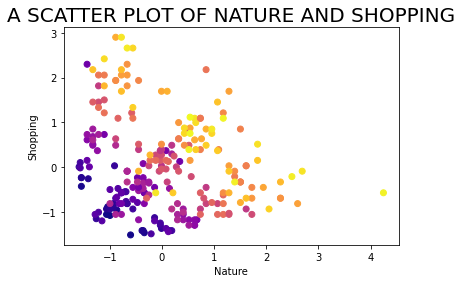

Silhouette Score: 0.173649709861068


In [383]:
from sklearn.cluster import DBSCAN
columns = ['Nature', 'Shopping']
X = pd.DataFrame(df, columns=columns)
scaler = StandardScaler()
scaled = scaler.fit_transform(X)
dbscan = DBSCAN(eps = 1, min_samples = 1).fit(X) # fitting the model
labels = dbscan.labels_ # getting the labels
plt.title('A SCATTER PLOT OF NATURE AND SHOPPING', fontsize = 20)
plt.scatter(scaled[:, 0], scaled[:,1], c = labels, cmap= "plasma") 
plt.xlabel("Nature") 
plt.ylabel("Shopping") 
plt.show() 

print(f'Silhouette Score: {silhouette_score(scaled, labels)}')

Task 4.8: Try any other Sklearn clustering model (you can choose whichever you like), plot the corresponding scatterplot so that datapoints belonging to different clusters have different colors, and finally also print the corresponding silhouette score.

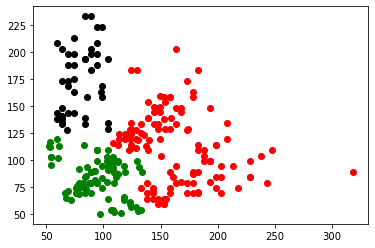

Silhouette Score: 0.38656160210589946


In [384]:
from sklearn.cluster import Birch
model = Birch(branching_factor=30, n_clusters=3, threshold=2.5)
model.fit(X)
labels = model.predict(X)
label_0 = data[labels == 0]
label_1 = data[labels == 1]
label_2 = data[labels == 2]
plt.scatter(label_0[cols[0]], label_0[cols[1]], color = 'red')
plt.scatter(label_1[cols[0]], label_1[cols[1]], color = 'black')
plt.scatter(label_2[cols[0]], label_2[cols[1]], color = 'green')
plt.show()

print(f'Silhouette Score: {silhouette_score(data, labels)}')


Task 4.9: Which one of the four clustering models gave the best performance in terms of the silhouette score? Also explain in your own words which one you would recommend, and why?

In [ ]:
# k-means clustering givs the best  k-means clustering value 0.4235451977419975 
# based on our data i would recomend  k-means  because based on the
# silhouette score its givs the best value 
# maybe on other data would chose other algorithm and it depends on the data 
# that we have 